C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


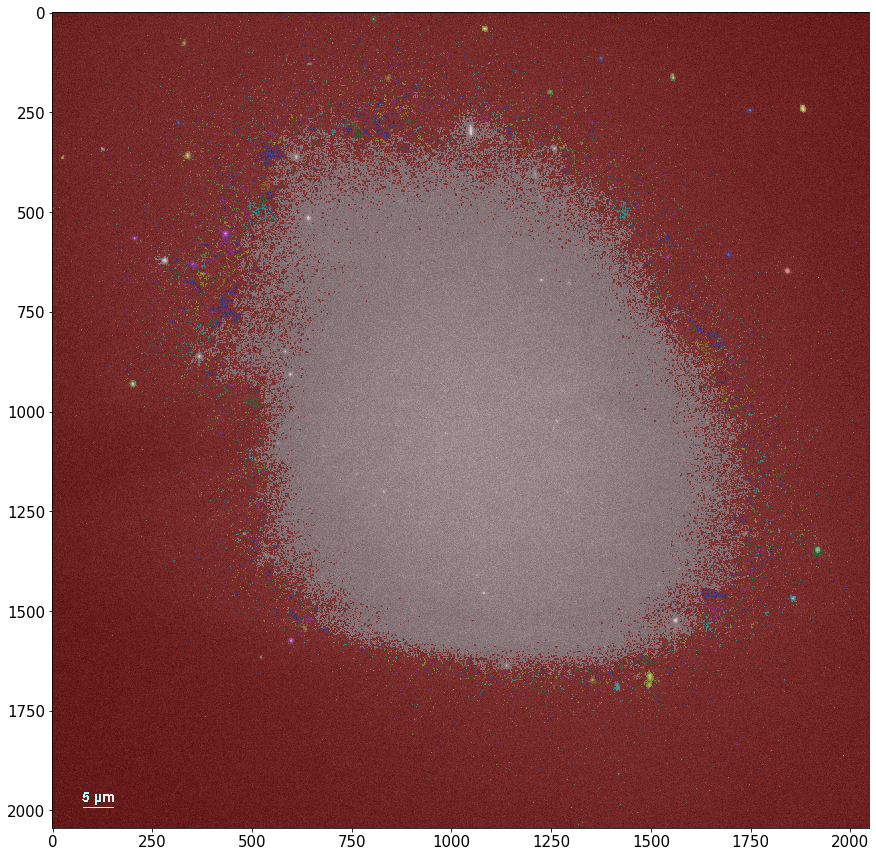

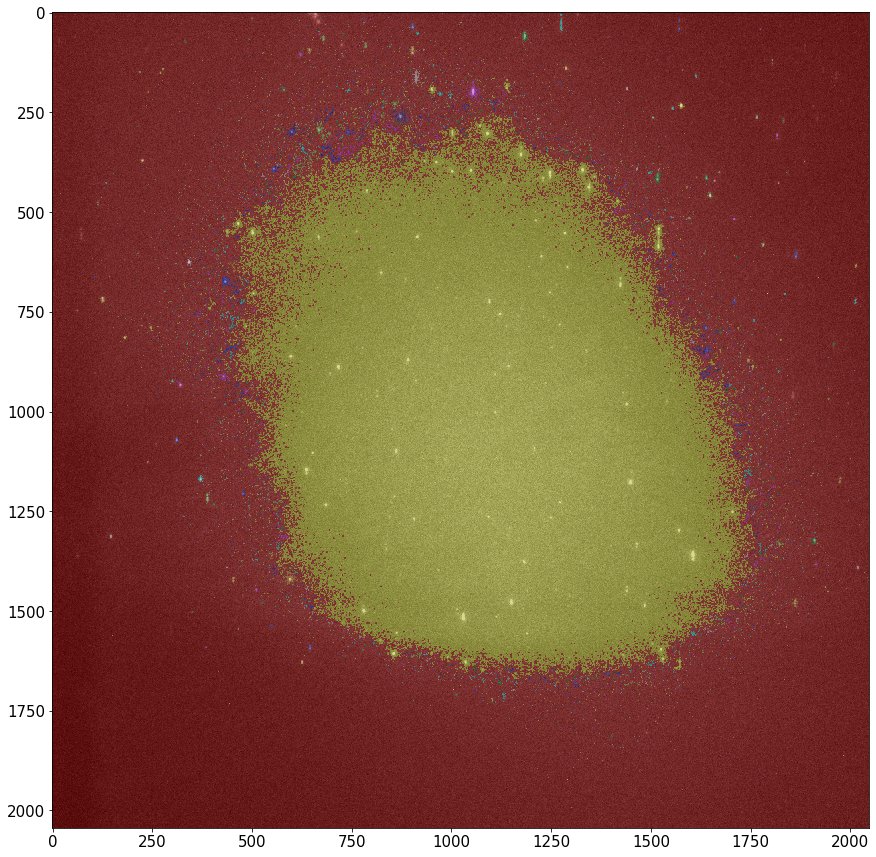

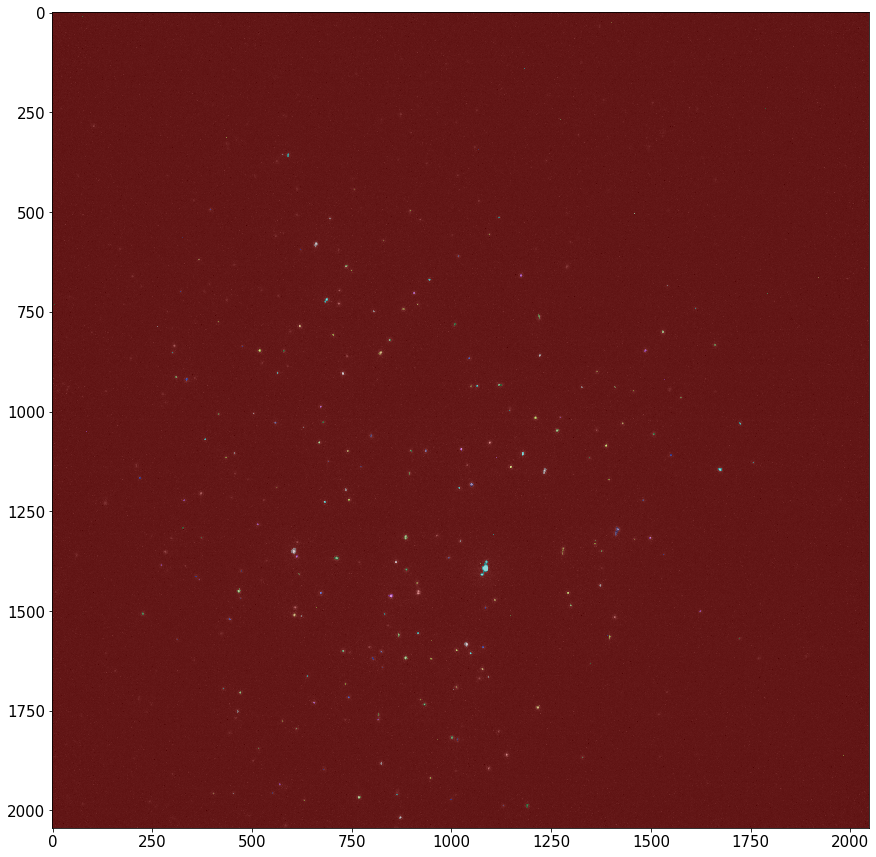

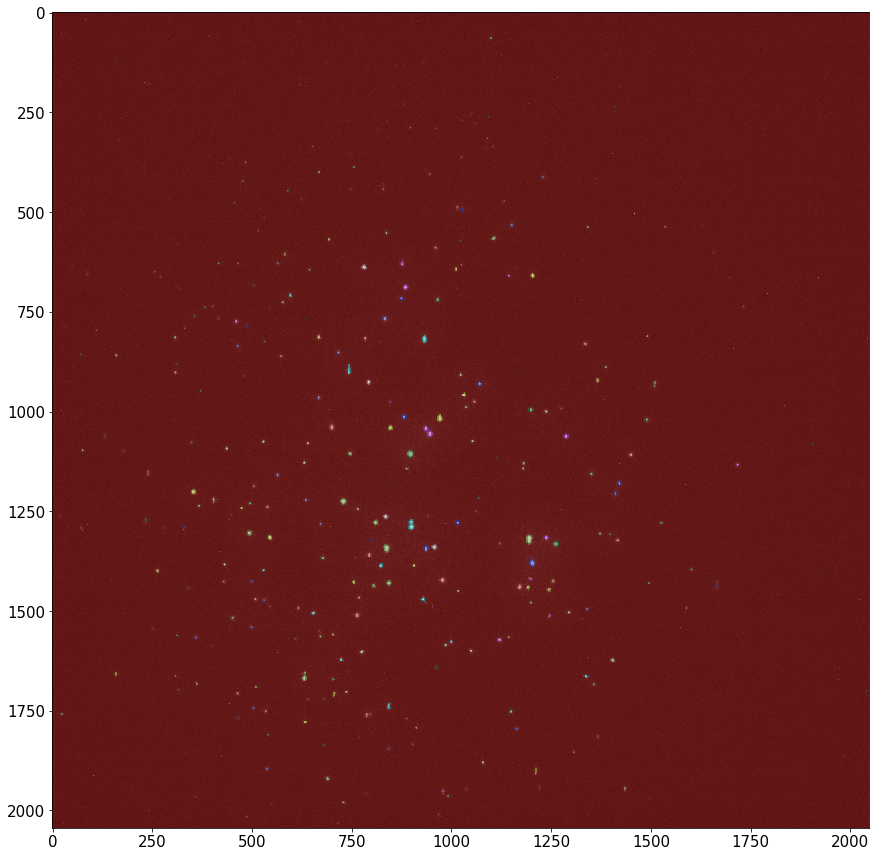

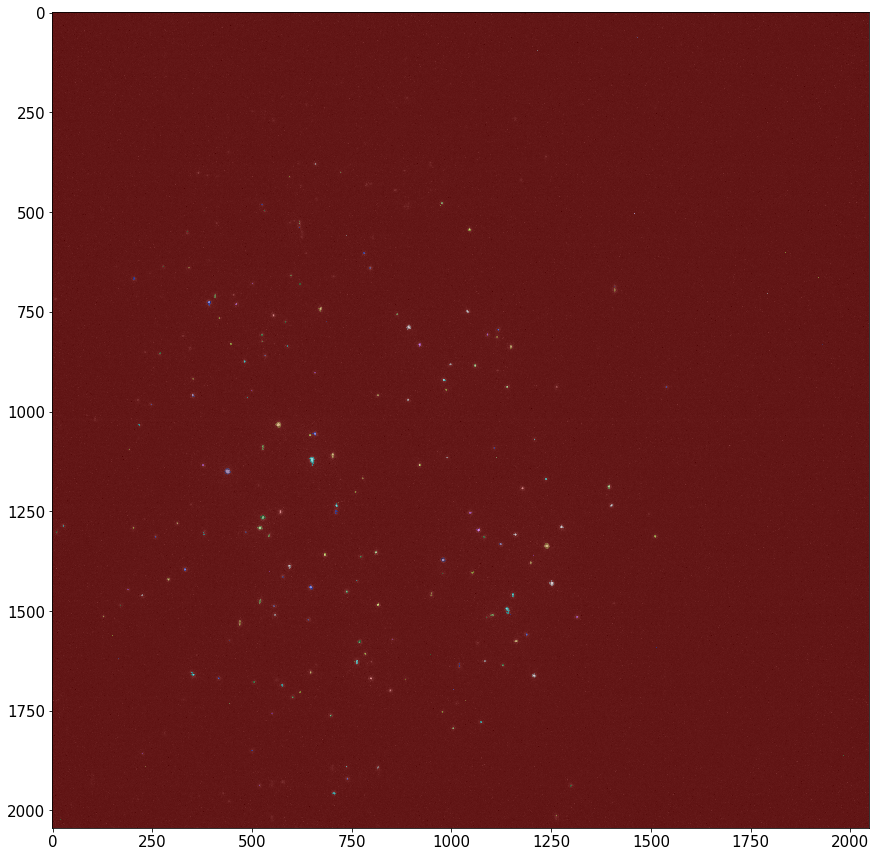

...

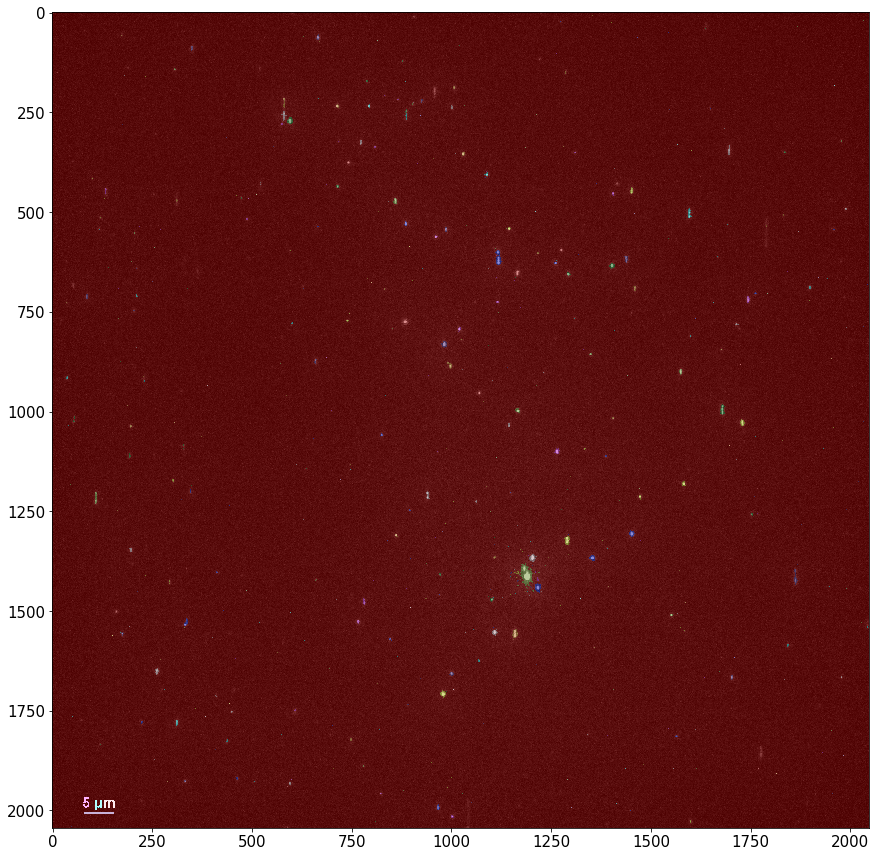

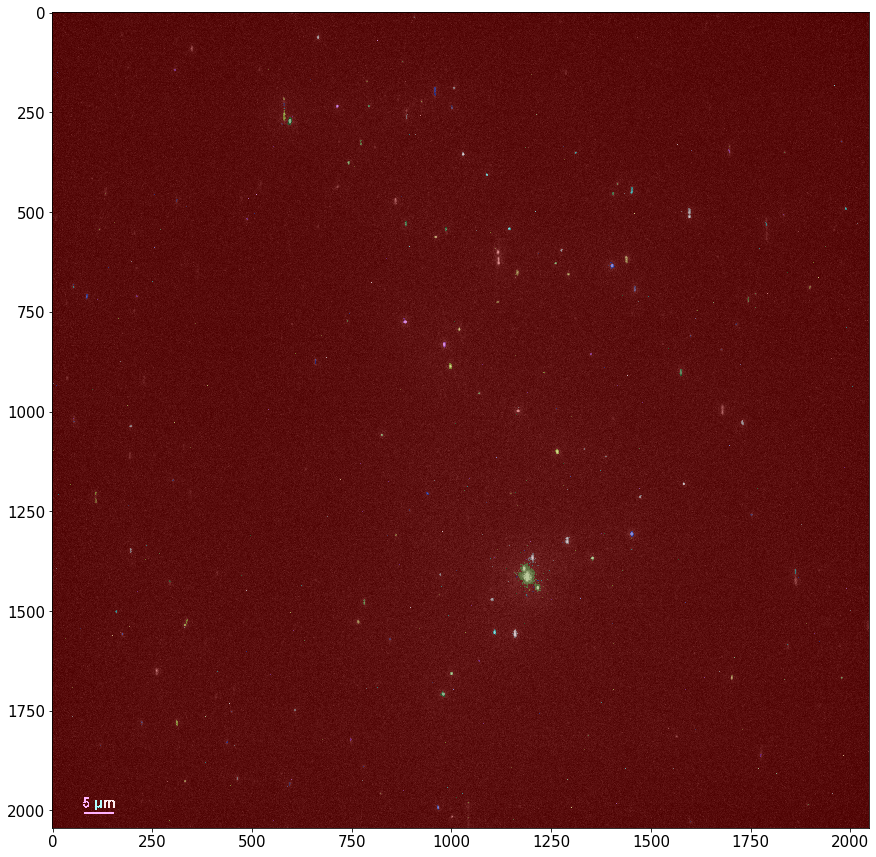

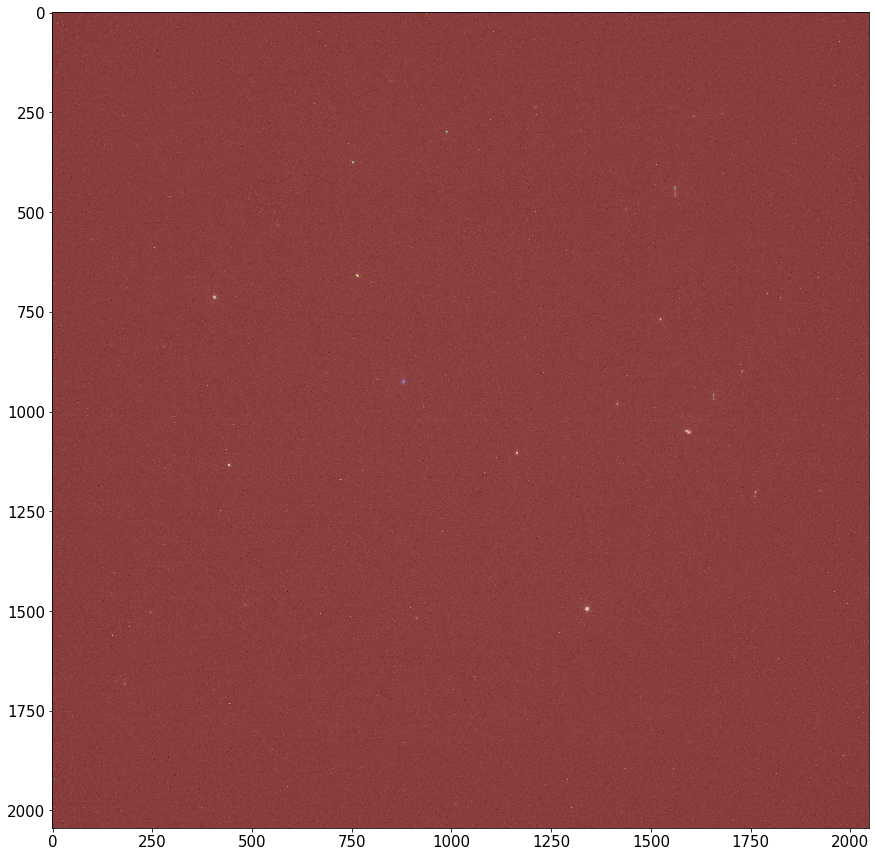

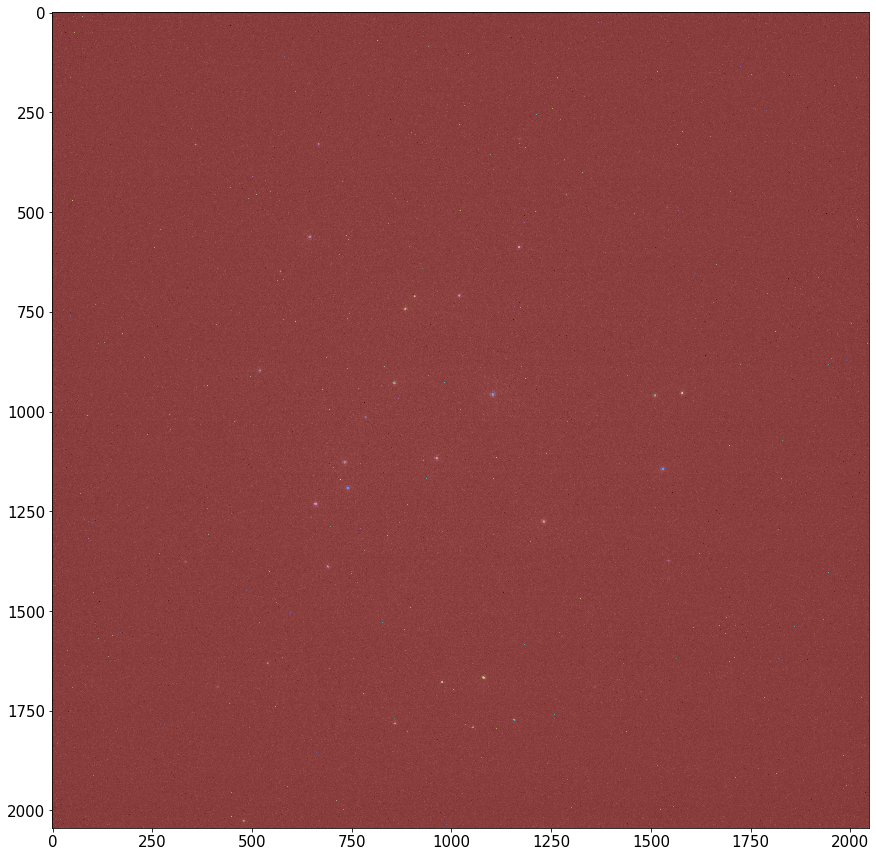

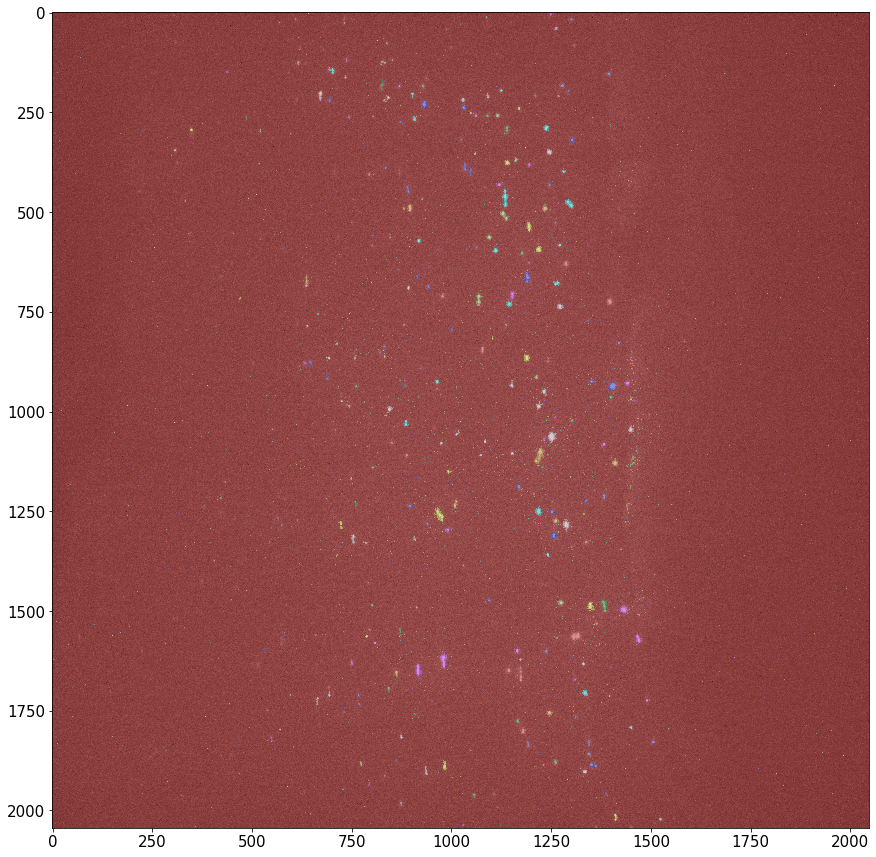

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from pylab import *
from pathlib import Path
from skimage.color import rgb2gray
from skimage.measure import label, regionprops
from skimage.filters import threshold_yen
from skimage.morphology import closing, square
from skimage.segmentation import clear_border
from skimage.color import label2rgb
%matplotlib inline

# iterate over all images in a certain folder
pathlist = Path('Raw data_All images/10k_27 images').glob('**/*.jpg')
for path in pathlist:
    path_in_str = str(path)
#    print(path_in_str)
    
    # open the image
    image = Image.open(path_in_str)
    img_array = np.array(image)
    image_gray = rgb2gray(img_array)
    
    # apply threshold
    image = image_gray
    thresh = threshold_yen(image)
    binary = image <= thresh
    bw = closing(image > thresh, square(3))
    plt.rcParams.update({'font.size': 15})
#    plt.figure(figsize = (15,15))
#    imshow(binary,cmap=plt.cm.gray)
    
    # remove artifacts connected to image border
    cleared = clear_border(bw)
    
    # label image regions
    label_image = label(cleared)
    image_label_overlay = label2rgb(label_image, image=image)
    fig, ax = plt.subplots(figsize=(15, 15))
    ax.imshow(image_label_overlay)
    
    # extract features
    props = regionprops(label_image,intensity_image=image_gray, coordinates='xy')

In [3]:
import pandas as pd

shear_rate_10k = pd.DataFrame(columns=['shear rate', 'eccentricity', 'convex_area',
                                      'major_axis_length','minor_axis_length','orientation'])

for i in props: 
        #exclude circular(folded) and small(might be background noise) dots
        if i.eccentricity>.5 and i.convex_area>20:                                
            shear_rate_10k = shear_rate_10k.append({'shear rate': 25000, 'eccentricity': i.eccentricity, 
                                                    'convex_area': i.convex_area,'major_axis_length': i.major_axis_length,
                                                   'minor_axis_length': i.minor_axis_length,'orientation': i.orientation},
                                                   ignore_index=True)

#print("10k_27 images", shear_rate_10k, sep='\n')

10k_3 images
     shear rate  eccentricity  convex_area  major_axis_length  \
0       25000.0      0.784105         47.0           9.619919   
1       25000.0      0.506052         58.0           8.802433   
2       25000.0      0.686365         57.0           9.345463   
3       25000.0      0.687205         24.0           6.180615   
4       25000.0      0.929222         35.0          10.363356   
5       25000.0      0.853991         83.0          13.209726   
6       25000.0      0.744851        115.0          15.027125   
7       25000.0      0.800139        208.0          19.828919   
8       25000.0      0.512876        117.0          12.901090   
9       25000.0      0.748840         44.0           8.762475   
10      25000.0      0.866276         30.0           8.321444   
11      25000.0      0.967311        204.0          29.673941   
12      25000.0      0.585804        148.0          14.235308   
13      25000.0      0.614226         60.0           9.475405   
14      2500

In [44]:
#save dataframe
shear_rate_10k.to_pickle('shear_rate_10k')
a = pd.read_pickle('shear_rate_10k')
print(a)

    shear rate  eccentricity  convex_area  major_axis_length  \
0      25000.0      0.740460         21.0           6.113020   
1      25000.0      0.924099         72.0          14.219881   
2      25000.0      0.749274         73.0          10.958702   
3      25000.0      0.818284         38.0           8.821430   
4      25000.0      0.641818         32.0           6.901410   
5      25000.0      0.813522         35.0           8.410870   
6      25000.0      0.841003        139.0          16.551067   
7      25000.0      0.649813        134.0          13.901363   
8      25000.0      0.736784         21.0           5.968676   
9      25000.0      0.561934         56.0           8.863853   
10     25000.0      0.971021         81.0          20.216784   
11     25000.0      0.608828         32.0           6.746835   
12     25000.0      0.821382        118.0          15.687968   
13     25000.0      0.785204         39.0           8.501932   
14     25000.0      0.783508         60.